# Setting Source Folder

In [70]:
import os, sys

filedir = os.path.abspath(".")

currentdir = os.path.dirname(os.path.abspath("."))  # workaround to adding local modules

parentdir = os.path.dirname(os.path.abspath("" + currentdir))
print(f"CurrentDir: {currentdir}")
print(f"ParentDir: {parentdir}")

sys.path.insert(0, currentdir)


CurrentDir: /Users/renan.cristofalo/Documents/git/multimorbity_use
ParentDir: /Users/renan.cristofalo/Documents/git


# IMPORTAÇÃO DAS BIBLIOTECAS

In [71]:
# pip install tensorflow-metal==0.5.0 tensorflow-macos==2.9


In [72]:
# What version of Python do you have?
import sys

import tensorflow.keras
import pandas as pd
import sklearn as sk
import tensorflow as tf
import platform

print(f"Python Platform: {platform.platform()}")
print(f"Tensor Flow Version: {tf.__version__}")
print(f"Keras Version: {tensorflow.keras.__version__}")
print()
print(f"Python {sys.version}")
print(f"Pandas {pd.__version__}")
print(f"Scikit-Learn {sk.__version__}")
gpu = len(tf.config.list_physical_devices("GPU")) > 0
print("GPU is", "available" if gpu else "NOT AVAILABLE")

# For M1 computers = https://www.youtube.com/watch?v=5DgWvU0p2bk&ab_channel=JeffHeaton


Python Platform: macOS-14.1.2-arm64-arm-64bit
Tensor Flow Version: 2.9.0
Keras Version: 2.9.0

Python 3.9.15 | packaged by conda-forge | (main, Nov 22 2022, 08:48:25) 
[Clang 14.0.6 ]
Pandas 1.3.0
Scikit-Learn 1.1.2
GPU is available


In [73]:
import pandas as pd
import numpy as np
import joblib
import os.path as osp
import logging

from src.visualization.data_visualization import *
from src.ml.model_selection import cross_validate_models, _create_metric_msg, create_df_results, RandomizedSearch, make_dnn_model
from src.ml.utils.preprocessors import select_preprocessor
from src.ml.utils.utils import write_joblib, read_joblib
from src.utils.utils import now_str
from src.ml.evaluation.evaluate import get_metric_result
from src.config import *

from sklearn.preprocessing import MinMaxScaler,StandardScaler, FunctionTransformer, PowerTransformer

from sklearn.pipeline import Pipeline
from sklearn.base import clone

from scikeras.wrappers import KerasClassifier

#Models
from sklearn.dummy import DummyClassifier
from sklearn.linear_model import RidgeClassifier, LogisticRegression
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier, LGBMRegressor #conda install lightgbm==3.3.2
from catboost import CatBoostClassifier
# from ngboost import NGBClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier, ExtraTreesClassifier, VotingClassifier, StackingClassifier
from sklearn.tree import DecisionTreeClassifier


from tensorflow.python.keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint

# explicitly require this experimental feature
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer, SimpleImputer

# import packages for imbalanced learn
from imblearn.combine import SMOTEENN
from imblearn.pipeline import Pipeline as Imb_Pipeline
from imblearn.ensemble import RUSBoostClassifier, BalancedRandomForestClassifier

import warnings
warnings.filterwarnings("ignore")

pd.options.display.float_format = '{:,.2f}'.format
%matplotlib inline


In [74]:
N_FOLDS = 10
SEED = 123
MODELS_DIR = osp.join("models", "v2")


# Definining Logs

In [75]:
def define_logs(logs_path):
    """Define the logs for the model selector

    Args:
        logs_path (str): Path to the log file
    """
    folder_path = osp.dirname(osp.abspath(logs_path))
    if not osp.exists(folder_path):
        os.makedirs(folder_path)

    log = logging.getLogger()
    log.setLevel(logging.INFO)
    fh = logging.FileHandler(filename=logs_path)
    fh.setLevel(logging.INFO)
    formatter = logging.Formatter(
        fmt="%(asctime)s %(levelname)s: %(message)s", datefmt="%Y-%m-%d %H:%M:%S"
    )
    fh.setFormatter(formatter)
    log.addHandler(fh)

    return log


In [76]:
logger = define_logs(osp.join(MODELS_DIR, "logs", f"{now_str()}-model_selection.logs"))


In [77]:
import json


def is_jsonable(x):
    try:
        json.dumps(x)
        return True
    except (TypeError, OverflowError):
        return False


# Model Training

## Defining Strategies

In [78]:
ALL_PATH = osp.join("..", "data", "feature_selection", "raw")
BORUTA_PATH = osp.join("..", "data", "feature_selection", "boruta")
FS_PATH = osp.join("..", "data", "feature_selection", "fs")
FM_PATH = osp.join("..", "data", "feature_selection", "FM")
FM_MUST_PATH = osp.join("..", "data", "feature_selection", "FM_MUST")
FS_MUST_PATH = osp.join("..", "data", "feature_selection", "fs_must")

STRATEGIES = {
    "ALL_FEATURES": {
        "description": "Training with all available features",
        "df_train": osp.join(ALL_PATH, "df_train.parquet"),
        "df_test": osp.join(ALL_PATH, "df_test.parquet"),
    },
    "BORUTA": {
        "description": "Training with features selected by the Boruta Feature Selection",
        "df_train": osp.join(BORUTA_PATH, "df_train.parquet"),
        "df_test": osp.join(BORUTA_PATH, "df_test.parquet"),
    },
    "FS": {
        "description": "Training with features selected by the Feature Selector",
        "df_train": osp.join(FS_PATH, "df_train.parquet"),
        "df_test": osp.join(FS_PATH, "df_test.parquet"),
    },
    "FM": {
        "description": "Training with features selected by the Feature Selector",
        "df_train": osp.join(FM_PATH, "df_train.parquet"),
        "df_test": osp.join(FM_PATH, "df_test.parquet"),
    },
    "FM_MUST": {
        "description": "Training with features selected by the Feature Selector",
        "df_train": osp.join(FM_MUST_PATH, "df_train.parquet"),
        "df_test": osp.join(FM_MUST_PATH, "df_test.parquet"),
    },
    "FS_MUST": {
        "description": "Training with filtered features selected by the Feature Selector combined with sampler SMOTEENN",
        "df_train": osp.join(FS_MUST_PATH, "df_train.parquet"),
        "df_test": osp.join(FS_MUST_PATH, "df_test.parquet"),
    },
}
for strategy, dict_strategy in STRATEGIES.items():
    logger.info(f"\n*************** {strategy} ***************\n")
    logger.info(
        json.dumps(
            {
                k: (str(v) if not is_jsonable(v) else v)
                for k, v in dict_strategy.items()
            },
            sort_keys=False,
            indent=3,
            skipkeys=True,
        )
    )

    # getting strategy parameters
    df_train_path = dict_strategy.get("df_train", None)
    df_test_path = dict_strategy.get("df_test", None)

    # reading files
    df_train = pd.read_parquet(df_train_path)
    df_test = pd.read_parquet(df_test_path)

    logger.info(
        f"\ndf_train shape: {df_train.shape} \n df_test shape: {df_test.shape}\n"
    )


## Defining Metrics

In [79]:
metrics = {
    "accuracy": "accuracy",
    "balanced_acc": "balanced_accuracy",
    "F1": "f1",
    "Precision": "precision",
    "recall": "recall",
    "roc_auc": "roc_auc",
}


## Defining Sklearn Models

In [80]:
models = []

# Make a pipeline for the model, scaling and making a cross validation for each of them
models.append({"name": "Dummy", "model": DummyClassifier()})

models.append({"name": "LogisticRegression", "model": LogisticRegression()})

models.append(
    {
        "name": "DecisionTreeClassifier",
        "model": DecisionTreeClassifier(
            min_samples_split=0.005, min_samples_leaf=0.001, random_state=SEED
        ),
    }
)

models.append(
    {
        "name": "RandomForestClassifier",
        "model": RandomForestClassifier(
            max_depth=7,
            random_state=SEED,
            min_samples_split=0.01,
            min_samples_leaf=0.005,
        ),
    }
)

models.append(
    {
        "name": "ExtraTreesClassifier",
        "model": ExtraTreesClassifier(
            max_depth=7,
            random_state=SEED,
            min_samples_split=0.01,
            min_samples_leaf=0.005,
        ),
    }
)

models.append(
    {
        "name": "GradientBoostingClassifier",
        "model": GradientBoostingClassifier(
            max_depth=7,
            random_state=SEED,
            min_samples_split=0.01,
            min_samples_leaf=0.005,
        ),
    }
)

models.append(
    {
        "name": "XGBoostClassifier",
        "model": XGBClassifier(max_depth=7, random_state=SEED),
    }
)

models.append(
    {"name": "XGBoostClassifier_Default", "model": XGBClassifier(random_state=SEED)}
)

models.append(
    {
        "name": "LGBMClassifier",
        "model": LGBMClassifier(max_depth=7, verbose=0, random_state=SEED),
    }
)

models.append(
    {"name": "LGBMClassifier_Default", "model": LGBMClassifier(random_state=SEED)}
)

models.append(
    {
        "name": "CatBoostClassifier",
        "model": CatBoostClassifier(max_depth=7, verbose=0, random_state=SEED),
    }
)

models.append(
    {
        "name": "CatBoostClassifier_Default",
        "model": CatBoostClassifier(random_state=SEED),
    }
)

models.append(
    {
        "name": "BalancedRandomForestClassifier",
        "model": BalancedRandomForestClassifier(random_state=SEED),
    }
)

models.append(
    {"name": "RUSBoostClassifier", "model": RUSBoostClassifier(random_state=SEED)}
)

models.append(
    {
        "name": "VotingClassifier",
        "model": VotingClassifier(
            estimators=[
                ("rf", RandomForestClassifier(n_estimators=10, random_state=42)),
                ("lgbm", LGBMClassifier(max_depth=10)),
                ("catboost", CatBoostClassifier(max_depth=10, verbose=False)),
                ("xgboost", XGBClassifier(max_depth=10, random_state=SEED)),
            ],
            voting="soft",
        ),
    }
)

models.append(
    {
        "name": "StackingClassifier",
        "model": StackingClassifier(
            estimators=[
                ("rf", RandomForestClassifier(n_estimators=10, random_state=42)),
                ("xgboost", XGBClassifier(max_depth=10, random_state=SEED)),
                ("lgbm", LGBMClassifier(max_depth=10)),
            ]
        ),
    }
)


## Defining Tensorflow Models

In [81]:
# models = []

PATIENCE = 5
NUM_EPOCHS = 30

BATCH_SIZE = 1024
seed = 42
verbose = 0


callbacks = {
    "EarlyStopping": tf.keras.callbacks.EarlyStopping,
}
tf_metrics = ["accuracy"]  # https://www.tensorflow.org/api_docs/python/tf/keras/metrics

models.append(
    {
        "name": "DNN_01",
        "model": KerasClassifier(
            model=make_dnn_model,
            optimizer="adam",
            network_layers=(1024, 1024, 512, 512),
            dropout_rate=0.3,
            epochs=NUM_EPOCHS,
            batch_size=BATCH_SIZE,
            callbacks=callbacks,
            callbacks__EarlyStopping__monitor="val_loss",
            callbacks__EarlyStopping__patience=PATIENCE,
            callbacks__EarlyStopping__restore_best_weights=True,
            validation_split=1 / N_FOLDS,
            verbose=0,
        ),
    }
)

models.append(
    {
        "name": "DNN_02",
        "model": KerasClassifier(
            model=make_dnn_model,
            optimizer="adam",
            network_layers=(1024, 512, 256, 128, 64, 32),
            dropout_rate=1 / N_FOLDS,
            epochs=NUM_EPOCHS,
            batch_size=BATCH_SIZE,
            callbacks=callbacks,
            callbacks__EarlyStopping__monitor="val_loss",
            callbacks__EarlyStopping__patience=PATIENCE,
            callbacks__EarlyStopping__restore_best_weights=True,
            validation_split=1 / N_FOLDS,
            verbose=0,
        ),
    }
)

models.append(
    {
        "name": "DNN_03",
        "model": KerasClassifier(
            model=make_dnn_model,
            optimizer="adam",
            network_layers=(128, 64, 32),
            dropout_rate=0.1,
            epochs=NUM_EPOCHS,
            batch_size=BATCH_SIZE,
            callbacks=callbacks,
            callbacks__EarlyStopping__monitor="val_loss",
            callbacks__EarlyStopping__patience=PATIENCE,
            callbacks__EarlyStopping__restore_best_weights=True,
            validation_split=1 / N_FOLDS,
            verbose=0,
        ),
    }
)

models.append(
    {
        "name": "DNN_04",
        "model": KerasClassifier(
            model=make_dnn_model,
            optimizer="adam",
            network_layers=(32, 16, 8),
            dropout_rate=0.1,
            epochs=NUM_EPOCHS,
            batch_size=BATCH_SIZE,
            callbacks=callbacks,
            callbacks__EarlyStopping__monitor="val_loss",
            callbacks__EarlyStopping__patience=PATIENCE,
            callbacks__EarlyStopping__restore_best_weights=True,
            validation_split=1 / N_FOLDS,
            verbose=0,
        ),
    }
)


models.append(
    {
        "name": "VotingClassifierDNN_01",
        "model": VotingClassifier(
            estimators=[
                ("rf", RandomForestClassifier(n_estimators=10, random_state=42)),
                ("lgbm", LGBMClassifier(max_depth=10)),
                (
                    "DNN_01",
                    KerasClassifier(
                        model=make_dnn_model,
                        optimizer="adam",
                        network_layers=(1024, 1024, 512, 512),
                        dropout_rate=0.3,
                        epochs=NUM_EPOCHS,
                        batch_size=BATCH_SIZE,
                        callbacks=callbacks,
                        callbacks__EarlyStopping__monitor="val_loss",
                        callbacks__EarlyStopping__patience=PATIENCE,
                        callbacks__EarlyStopping__restore_best_weights=True,
                        validation_split=1 / N_FOLDS,
                        verbose=0,
                    ),
                ),
            ],
            voting="soft",
        ),
    }
)


## Running Models' Training

In [ ]:
for strategy, dict_strategy in STRATEGIES.items():
    # logging strategy
    logger.info(f"*************** {strategy} ***************")
    logger.info(
        json.dumps(
            {
                k: (str(v) if not is_jsonable(v) else v)
                for k, v in dict_strategy.items()
            },
            sort_keys=False,
            indent=4,
            skipkeys=True,
        )
    )

    # getting strategy parameters
    df_train_path = dict_strategy.get("df_train", None)
    df_test_path = dict_strategy.get("df_test", None)
    imbalanced_sampler = dict_strategy.get("imbalanced_sampler", None)

    # reading files
    df_train = pd.read_parquet(df_train_path)
    df_test = pd.read_parquet(df_test_path)

    logger.info(f"df_train shape: {df_train.shape}")
    logger.info(f"df_test shape: {df_test.shape}")

    X_train_ = df_train.drop([TARGET], axis=1)
    y_train_ = df_train[TARGET]
    X_test_ = df_test.drop([TARGET], axis=1)
    y_test_ = df_test[TARGET]

    # Adding preprocessor
    preprocessor = None
    preprocessor = select_preprocessor("TargetEncoding", X=X_train_)

    strategy_models = []
    if imbalanced_sampler:
        df_train = pd.read_parquet(df_train_path).sample(10000)
        X_train_ = df_train.drop([TARGET], axis=1)
        y_train_ = df_train[TARGET]

        for model in models:
            strategy_models.append(
                {
                    "name": strategy + "_" + model["name"],
                    "model": Imb_Pipeline(
                        steps=[
                            ("preprocessor", preprocessor),
                            ("sampling", imbalanced_sampler),
                            ("model", model["model"]),
                        ]
                    ),
                }
            )
    else:
        for model in models:
            strategy_models.append(
                {
                    "name": strategy + "_" + model["name"],
                    "model": Pipeline(
                        steps=[
                            ("preprocessor", preprocessor),
                            ("model", model["model"]),
                        ]
                    ),
                }
            )

    names, results, df_results = cross_validate_models(
        models=strategy_models,
        X_train=X_train_,
        y_train=y_train_,
        X_test=X_test_,
        y_test=y_test_,
        metrics=metrics,
        n_folds=N_FOLDS,
        models_dir=MODELS_DIR,
    )


In [82]:
trained_models, results = {}, {}
for strategy, dict_strategy in STRATEGIES.items():
    for model in models:
        try:
            trained_models[strategy + "_" + model["name"]] = read_joblib(
                osp.join(MODELS_DIR, strategy + "_" + model["name"], "model.p")
            )
            metric_dict = read_joblib(
                osp.join(MODELS_DIR, strategy + "_" + model["name"], "metrics.p")
            )
            results.update(metric_dict)
        except:
            pass

    write_joblib(results, osp.join(MODELS_DIR, f"results.p"))
    results = read_joblib(osp.join(MODELS_DIR, "results.p"))


In [46]:
for name, model_metric in results.items():
    msg_metrics = _create_metric_msg(model_metric)

    # print of the result of each model
    print(f"\nAVERAGES - {name.upper()}:\n" + msg_metrics)
    logger.info(f"\nAVERAGES - {name.upper()}:\n" + msg_metrics)



AVERAGES - ALL_FEATURES_DUMMY:
 - ACCURACY               ->  - TRAIN: 0.52 (+/- 0.00) | VALIDATION: 0.52 (+/- 0.00) | TEST: 0.47 (+/- 0.00)
 - BALANCED_ACC           ->  - TRAIN: 0.50 (+/- 0.00) | VALIDATION: 0.50 (+/- 0.00) | TEST: 0.50 (+/- 0.00)
 - F1                     ->  - TRAIN: 0.00 (+/- 0.00) | VALIDATION: 0.00 (+/- 0.00) | TEST: 0.00 (+/- 0.00)
 - PRECISION              ->  - TRAIN: 0.00 (+/- 0.00) | VALIDATION: 0.00 (+/- 0.00) | TEST: 0.00 (+/- 0.00)
 - RECALL                 ->  - TRAIN: 0.00 (+/- 0.00) | VALIDATION: 0.00 (+/- 0.00) | TEST: 0.00 (+/- 0.00)
 - ROC_AUC                ->  - TRAIN: 0.50 (+/- 0.00) | VALIDATION: 0.50 (+/- 0.00) | TEST: 0.50 (+/- 0.00)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.23s (+/- 0.03s)


AVERAGES - ALL_FEATURES_LOGISTICREGRESSION:
 - ACCURACY               ->  - TRAIN: 0.83 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.03) | TEST: 0.58 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.83 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.03) | TEST: 0.58 (+/-

In [47]:
df_results = create_df_results(results, models=None, slim=False)
df_results_slim = create_df_results(results, models=None, slim=True)


In [48]:
metrics = df_results.select_dtypes(float).columns.to_list()

compare_model_results(
    df=df_results,
    names="models",
    metrics=metrics,
    save_path=osp.join("figures", "compare_models.png"),
)


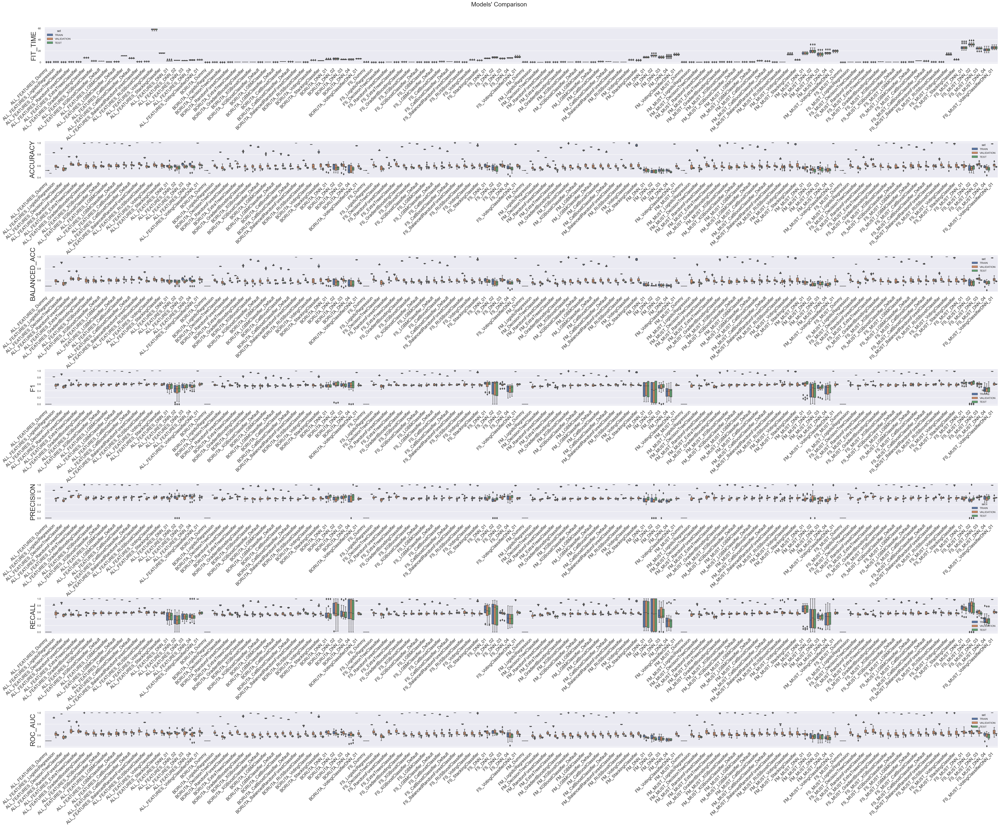

In [49]:
metrics = df_results_slim.select_dtypes(float).columns.to_list()

compare_model_results(
    df=df_results_slim,
    names="models",
    metrics=metrics,
    save_path=osp.join("figures", "compare_models_slim.png"),
    hue="set",
)


# Analyzing the Results

In [83]:
df_results.sample(10)


,models,FIT_TIME,TEST_ACCURACY,TRAIN_ACCURACY,VALIDATION_ACCURACY,TEST_BALANCED_ACC,TRAIN_BALANCED_ACC,VALIDATION_BALANCED_ACC,TEST_F1,TRAIN_F1,VALIDATION_F1,TEST_PRECISION,TRAIN_PRECISION,VALIDATION_PRECISION,TEST_RECALL,TRAIN_RECALL,VALIDATION_RECALL,TEST_ROC_AUC,TRAIN_ROC_AUC,VALIDATION_ROC_AUC
919,FS_DecisionTreeClassifier,0.04,0.55,0.86,0.53,0.55,0.86,0.53,0.54,0.85,0.50,0.59,0.86,0.51,0.50,0.85,0.50,0.59,0.95,0.54
587,FM_MUST_CatBoostClassifier_Default,1.73,0.59,0.88,0.58,0.59,0.88,0.58,0.60,0.87,0.55,0.62,0.91,0.57,0.58,0.84,0.53,0.62,0.96,0.61
163,ALL_FEATURES_StackingClassifier,16.20,0.60,1.00,0.64,0.61,1.00,0.64,0.61,1.00,0.62,0.64,1.00,0.64,0.58,1.00,0.59,0.64,1.00,0.70
86,ALL_FEATURES_Dummy,0.22,0.47,0.52,0.52,0.50,0.50,0.50,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.50,0.50,0.50
322,BORUTA_LGBMClassifier,0.20,0.54,0.82,0.62,0.55,0.82,0.61,0.53,0.80,0.58,0.58,0.85,0.62,0.48,0.76,0.54,0.57,0.91,0.63
786,FM_RandomForestClassifier,0.19,0.57,0.74,0.61,0.57,0.74,0.60,0.56,0.72,0.58,0.61,0.76,0.59,0.51,0.68,0.56,0.60,0.82,0.64
874,FS_DNN_01,6.71,0.54,0.58,0.58,0.56,0.57,0.56,0.33,0.35,0.34,0.72,0.70,0.68,0.22,0.24,0.23,0.61,0.65,0.64
559,FM_LogisticRegression,0.09,0.55,0.69,0.56,0.56,0.69,0.56,0.55,0.66,0.50,0.59,0.69,0.55,0.52,0.63,0.47,0.57,0.76,0.60
400,BORUTA_XGBoostClassifier,0.12,0.55,0.95,0.55,0.55,0.95,0.55,0.55,0.94,0.54,0.58,0.96,0.53,0.51,0.93,0.55,0.56,0.99,0.59
462,FM_DNN_02,10.79,0.53,0.48,0.48,0.50,0.50,0.50,0.69,0.65,0.65,0.53,0.48,0.48,1.00,1.00,1.00,0.51,0.56,0.49


In [96]:
df_results[
    ["models"] + [col for col in df_results.columns if "VALIDATION" in col]
].groupby(["models"]).agg(["mean", "std"]).sort_values(
    by=("VALIDATION_ROC_AUC", "mean"), ascending=False
)


VALIDATION_ACCURACY       \
                                                           mean  std   
models                                                                 
ALL_FEATURES_RandomForestClassifier                        0.64 0.02   
FS_MUST_ExtraTreesClassifier                               0.63 0.04   
ALL_FEATURES_BalancedRandomForestClassifier                0.63 0.03   
ALL_FEATURES_ExtraTreesClassifier                          0.64 0.03   
FS_MUST_RandomForestClassifier                             0.63 0.03   
...                                                         ...  ...   
BORUTA_Dummy                                               0.52 0.00   
FS_MUST_Dummy                                              0.52 0.00   
FM_MUST_Dummy                                              0.52 0.00   
FS_Dummy                                                   0.52 0.00   
ALL_FEATURES_Dummy                                         0.52 0.00   

                                            VALIDATION_BALANCED_ACC       \
                                                               mean  std   
models                                                                     
ALL_FEATURES_RandomForestClassifier                            0.63 0.02   
FS_MUST_ExtraTreesClassifier                                   0.63 0.04   
ALL_FEATURES_BalancedRandomForestClassifier                    0.63 0.03   
ALL_FEATURES_ExtraTreesClassifier                              0.63 0.03   
FS_MUST_RandomForestClassifier                                 0.62 0.03   
...                                                             ...  ...   
BORUTA_Dummy                                                   0.50 0.00   
FS_MUST_Dummy                                                  0.50 0.00   
FM_MUST_Dummy                                                  0.50 0.00   
FS_Dummy                                                       0.50 0.00   
ALL_FEATURES_Dummy                                             0.50 0.00   

                                            VALIDATION_F1       \
                                                     mean  std   
models                                                           
ALL_FEATURES_RandomForestClassifier                  0.58 0.03   
FS_MUST_ExtraTreesClassifier                         0.58 0.04   
ALL_FEATURES_BalancedRandomForestClassifier          0.62 0.03   
ALL_FEATURES_ExtraTreesClassifier                    0.58 0.04   
FS_MUST_RandomForestClassifier                       0.59 0.03   
...                                                   ...  ...   
BORUTA_Dummy                                         0.00 0.00   
FS_MUST_Dummy                                        0.00 0.00   
FM_MUST_Dummy                                        0.00 0.00   
FS_Dummy                                             0.00 0.00   
ALL_FEATURES_Dummy                                   0.00 0.00   

                                            VALIDATION_PRECISION       \
                                                            mean  std   
models                                                                  
ALL_FEATURES_RandomForestClassifier                         0.65 0.03   
FS_MUST_ExtraTreesClassifier                                0.64 0.05   
ALL_FEATURES_BalancedRandomForestClassifier                 0.62 0.03   
ALL_FEATURES_ExtraTreesClassifier                           0.65 0.04   
FS_MUST_RandomForestClassifier                              0.63 0.04   
...                                                          ...  ...   
BORUTA_Dummy                                                0.00 0.00   
FS_MUST_Dummy                                               0.00 0.00   
FM_MUST_Dummy                                               0.00 0.00   
FS_Dummy                                                    0.00 0.00   
ALL_FEATURES_Dummy                                          0.00 0.00   

                      

In [99]:
df_results[["models"] + [col for col in df_results.columns if "TEST" in col]].groupby(
    ["models"]
).agg(["mean", "std"]).sort_values(
    by=("TEST_ROC_AUC", "mean"), ascending=False
).to_excel(
    "excel/results_v2_test.xlsx"
)
df_results[
    ["models"] + [col for col in df_results.columns if "VALIDATION" in col]
].groupby(["models"]).agg(["mean", "std"]).sort_values(
    by=("VALIDATION_ROC_AUC", "mean"), ascending=False
).to_excel(
    "excel/results_v2_validation.xlsx"
)


In [84]:
df_results.groupby(["models"]).mean().nlargest(10, "VALIDATION_ROC_AUC").sort_values(
    "VALIDATION_ROC_AUC", ascending=False
)


,FIT_TIME,TEST_ACCURACY,TRAIN_ACCURACY,VALIDATION_ACCURACY,TEST_BALANCED_ACC,TRAIN_BALANCED_ACC,VALIDATION_BALANCED_ACC,TEST_F1,TRAIN_F1,VALIDATION_F1,TEST_PRECISION,TRAIN_PRECISION,VALIDATION_PRECISION,TEST_RECALL,TRAIN_RECALL,VALIDATION_RECALL,TEST_ROC_AUC,TRAIN_ROC_AUC,VALIDATION_ROC_AUC
models,,,,,,,,,,,,,,,,,,,
ALL_FEATURES_RandomForestClassifier,0.44,0.61,0.76,0.64,0.62,0.76,0.63,0.58,0.73,0.58,0.68,0.80,0.65,0.51,0.66,0.53,0.67,0.85,0.68
FS_MUST_ExtraTreesClassifier,0.12,0.59,0.71,0.63,0.60,0.71,0.63,0.56,0.67,0.58,0.65,0.74,0.64,0.49,0.62,0.53,0.64,0.79,0.68
ALL_FEATURES_BalancedRandomForestClassifier,0.87,0.61,1.00,0.63,0.61,1.00,0.63,0.62,1.00,0.62,0.65,1.00,0.62,0.59,1.00,0.62,0.66,1.00,0.68
ALL_FEATURES_ExtraTreesClassifier,0.46,0.62,0.76,0.64,0.62,0.76,0.63,0.58,0.72,0.58,0.69,0.82,0.65,0.51,0.64,0.51,0.67,0.84,0.68
FS_MUST_RandomForestClassifier,0.16,0.60,0.75,0.63,0.60,0.74,0.62,0.59,0.72,0.59,0.65,0.76,0.63,0.54,0.68,0.56,0.64,0.83,0.67
FS_ExtraTreesClassifier,0.09,0.59,0.71,0.63,0.60,0.70,0.63,0.56,0.67,0.58,0.65,0.73,0.64,0.50,0.61,0.54,0.63,0.78,0.66
FS_DNN_03,6.65,0.60,0.63,0.62,0.61,0.62,0.61,0.59,0.59,0.58,0.65,0.62,0.61,0.54,0.57,0.56,0.64,0.67,0.66
ALL_FEATURES_VotingClassifierDNN_01,4.04,0.61,0.99,0.62,0.61,0.99,0.62,0.61,0.99,0.59,0.64,1.00,0.62,0.58,0.99,0.57,0.64,1.00,0.66
FM_MUST_RandomForestClassifier,0.16,0.59,0.75,0.62,0.59,0.75,0.62,0.58,0.73,0.59,0.63,0.77,0.62,0.54,0.69,0.56,0.63,0.83,0.66


In [52]:
df_results.groupby(["models"]).mean().nlargest(5, "VALIDATION_F1").sort_values(
    "VALIDATION_F1", ascending=False
)


,FIT_TIME,TEST_ACCURACY,TRAIN_ACCURACY,VALIDATION_ACCURACY,TEST_BALANCED_ACC,TRAIN_BALANCED_ACC,VALIDATION_BALANCED_ACC,TEST_F1,TRAIN_F1,VALIDATION_F1,TEST_PRECISION,TRAIN_PRECISION,VALIDATION_PRECISION,TEST_RECALL,TRAIN_RECALL,VALIDATION_RECALL,TEST_ROC_AUC,TRAIN_ROC_AUC,VALIDATION_ROC_AUC
models,,,,,,,,,,,,,,,,,,,
FS_MUST_DNN_01,26.80,0.60,0.61,0.60,0.59,0.62,0.60,0.64,0.64,0.63,0.61,0.58,0.57,0.67,0.71,0.70,0.64,0.66,0.65
ALL_FEATURES_BalancedRandomForestClassifier,0.87,0.61,1.00,0.63,0.61,1.00,0.63,0.62,1.00,0.62,0.65,1.00,0.62,0.59,1.00,0.62,0.66,1.00,0.68
FS_MUST_DNN_03,24.12,0.60,0.63,0.63,0.60,0.63,0.63,0.59,0.60,0.60,0.65,0.62,0.62,0.55,0.59,0.59,0.64,0.67,0.66
FS_MUST_VotingClassifierDNN_01,25.83,0.58,0.98,0.61,0.58,0.98,0.61,0.60,0.98,0.60,0.61,0.99,0.60,0.59,0.98,0.61,0.62,1.00,0.65
ALL_FEATURES_VotingClassifier,57.61,0.60,1.00,0.62,0.61,1.00,0.62,0.61,1.00,0.60,0.64,1.00,0.61,0.58,1.00,0.59,0.64,1.00,0.66


In [53]:
df_results.groupby(["models"]).mean().nlargest(
    5, "VALIDATION_BALANCED_ACC"
).sort_values("VALIDATION_BALANCED_ACC", ascending=False)


,FIT_TIME,TEST_ACCURACY,TRAIN_ACCURACY,VALIDATION_ACCURACY,TEST_BALANCED_ACC,TRAIN_BALANCED_ACC,VALIDATION_BALANCED_ACC,TEST_F1,TRAIN_F1,VALIDATION_F1,TEST_PRECISION,TRAIN_PRECISION,VALIDATION_PRECISION,TEST_RECALL,TRAIN_RECALL,VALIDATION_RECALL,TEST_ROC_AUC,TRAIN_ROC_AUC,VALIDATION_ROC_AUC
models,,,,,,,,,,,,,,,,,,,
ALL_FEATURES_BalancedRandomForestClassifier,0.87,0.61,1.00,0.63,0.61,1.00,0.63,0.62,1.00,0.62,0.65,1.00,0.62,0.59,1.00,0.62,0.66,1.00,0.68
ALL_FEATURES_ExtraTreesClassifier,0.46,0.62,0.76,0.64,0.62,0.76,0.63,0.58,0.72,0.58,0.69,0.82,0.65,0.51,0.64,0.51,0.67,0.84,0.68
ALL_FEATURES_RandomForestClassifier,0.44,0.61,0.76,0.64,0.62,0.76,0.63,0.58,0.73,0.58,0.68,0.80,0.65,0.51,0.66,0.53,0.67,0.85,0.68
FS_MUST_DNN_03,24.12,0.60,0.63,0.63,0.60,0.63,0.63,0.59,0.60,0.60,0.65,0.62,0.62,0.55,0.59,0.59,0.64,0.67,0.66
FS_ExtraTreesClassifier,0.09,0.59,0.71,0.63,0.60,0.70,0.63,0.56,0.67,0.58,0.65,0.73,0.64,0.50,0.61,0.54,0.63,0.78,0.66


In [54]:
SELECTED_MODELS = sorted(
    [
        col
        for col in results.keys()
        if "Dummy" not in col and results[col]["ROC_AUC"]["VALIDATION"].mean() > 0.65
    ]
)
THRESHOLD = 0.5


In [55]:
# reading files

df_train = pd.read_parquet(osp.join(ALL_PATH, "df_train.parquet"))
df_test = pd.read_parquet(osp.join(ALL_PATH, "df_test.parquet"))

logger.info(f"df_train shape: {df_train.shape}")
logger.info(f"df_test shape: {df_test.shape}")

X_train = df_train.drop([TARGET], axis=1)
y_train = df_train[TARGET]
X_test = df_test.drop([TARGET], axis=1)
y_test = df_test[TARGET]


In [56]:
predictions = {}
predictions_proba = {}
for name, model in trained_models.items():
    if name in SELECTED_MODELS:
        predictions[name] = model.predict(X_test)
        predictions_proba[name] = model.predict_proba(X_test)[:, 1]


2023-12-03 19:16:09.720531: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-12-03 19:16:15.497246: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-12-03 19:16:17.990051: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-12-03 19:16:20.382568: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-12-03 19:16:23.077639: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-12-03 19:16:26.322172: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-12-03 19:16:28.682318: I tensorflow/core/grappler/optimizers/cust

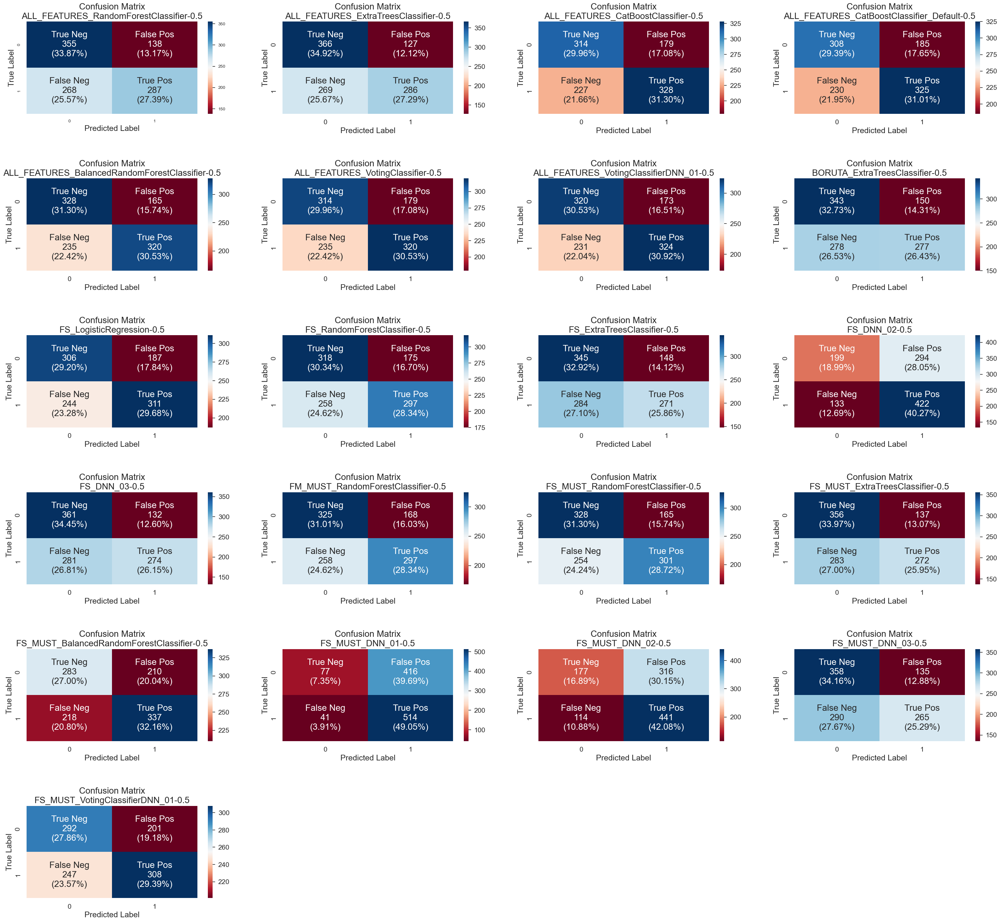

In [57]:
import matplotlib.pyplot as plt
import math

ncols = 4

size = len(predictions)
rows = math.ceil(size / ncols)
width, height = (10, 6)

fig = plt.figure(figsize=(min(ncols * width, 50), rows * height))
fig.subplots_adjust(hspace=0.7, wspace=0.2)

for idx, (name, y_pred) in enumerate(predictions.items(), start=1):
    ax = fig.add_subplot(rows, ncols, idx)
    plot_confusion_matrix(
        y_real=y_test,
        y_pred=y_pred,
        title=f"Confusion Matrix\n{name}-{round(THRESHOLD,2)}",
        ax=ax,
    )


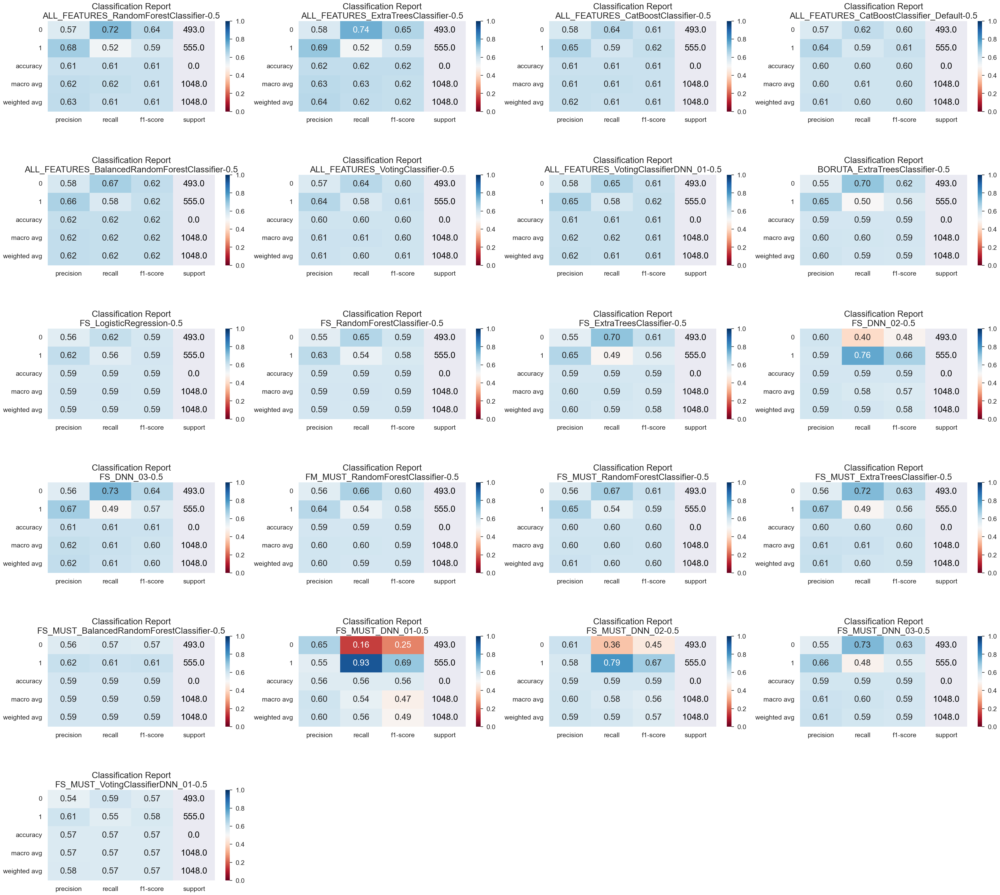

In [58]:
import matplotlib.pyplot as plt
import math

ncols = 4

size = len(predictions)
rows = math.ceil(size / ncols)
width, height = (10, 6)

fig = plt.figure(figsize=(min(ncols * width, 50), rows * height))
fig.subplots_adjust(hspace=0.7, wspace=0.2)

for idx, (name, y_pred) in enumerate(predictions.items(), start=1):
    ax = fig.add_subplot(rows, ncols, idx)
    plot_classification_report_sns(
        y_real=y_test,
        y_pred=y_pred,
        title=f"Classification Report\n{name}-{round(THRESHOLD,2)}",
        ax=ax,
    )


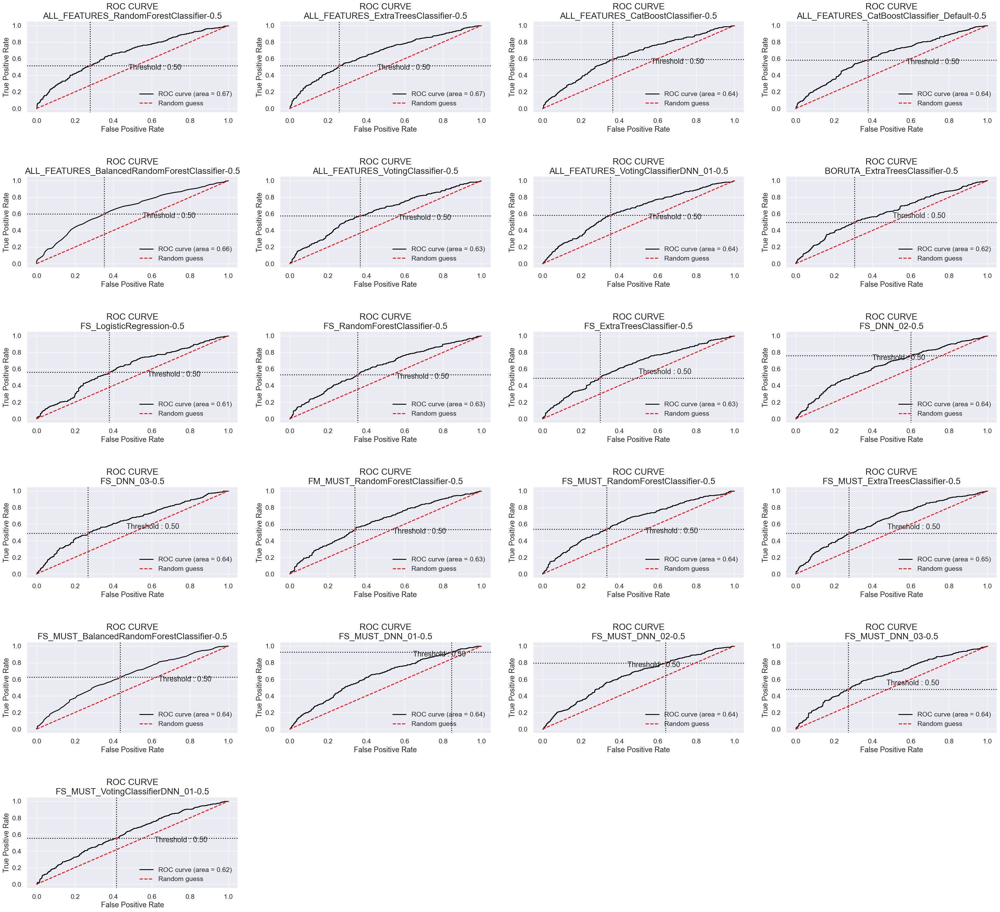

In [59]:
import matplotlib.pyplot as plt
import math

ncols = 4

size = len(predictions_proba)
rows = math.ceil(size / ncols)
width, height = (10, 6)

fig = plt.figure(figsize=(min(ncols * width, 50), rows * height))
fig.subplots_adjust(hspace=0.7, wspace=0.2)

for idx, (name, y_pred) in enumerate(predictions_proba.items(), start=1):
    ax = fig.add_subplot(rows, ncols, idx)
    plot_roc_sns(
        y_real=y_test,
        y_pred=y_pred,
        title=f"ROC CURVE\n{name}-{round(THRESHOLD,2)}",
        ax=ax,
    )


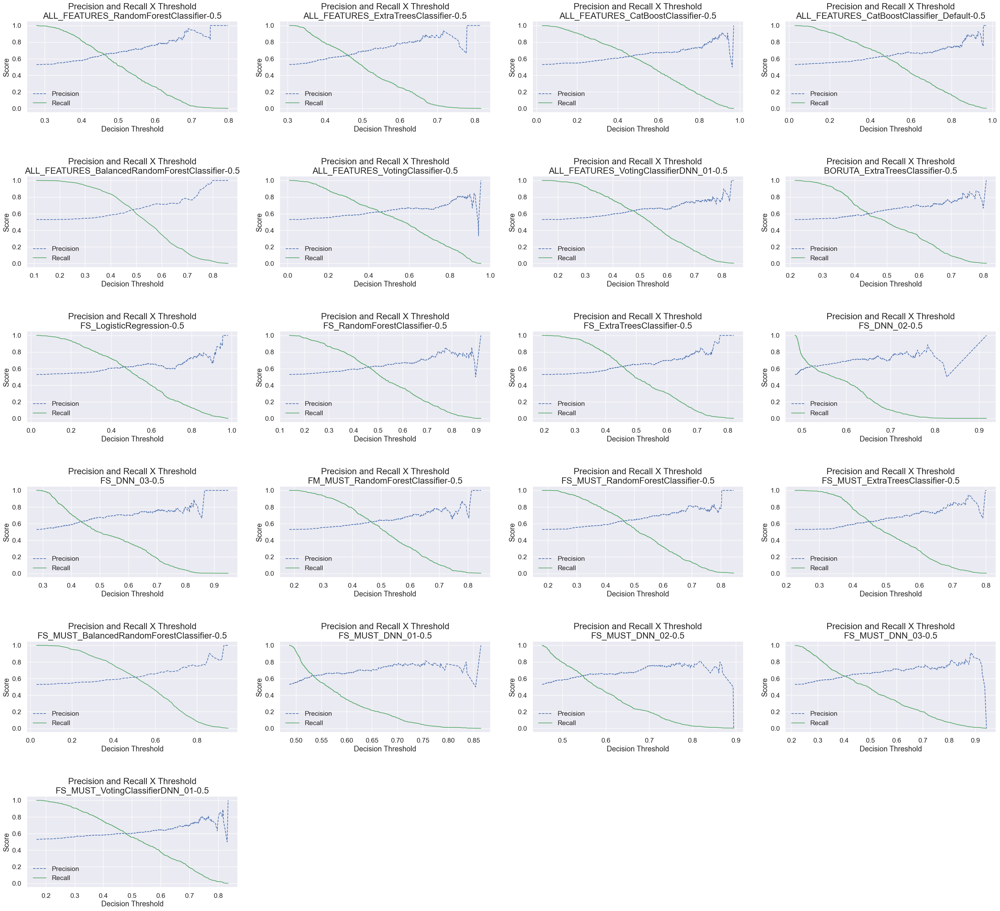

In [60]:
import matplotlib.pyplot as plt
import math

ncols = 4

size = len(predictions_proba)
rows = math.ceil(size / ncols)
width, height = (10, 6)

fig = plt.figure(figsize=(min(ncols * width, 50), rows * height))
fig.subplots_adjust(hspace=0.7, wspace=0.2)

for idx, (name, y_pred) in enumerate(predictions_proba.items(), start=1):
    ax = fig.add_subplot(rows, ncols, idx)
    plot_precision_recall_vs_threshold(
        y_real=y_test,
        y_pred=y_pred,
        title=f"Precision and Recall X Threshold\n{name}-{round(THRESHOLD,2)}",
        ax=ax,
    )


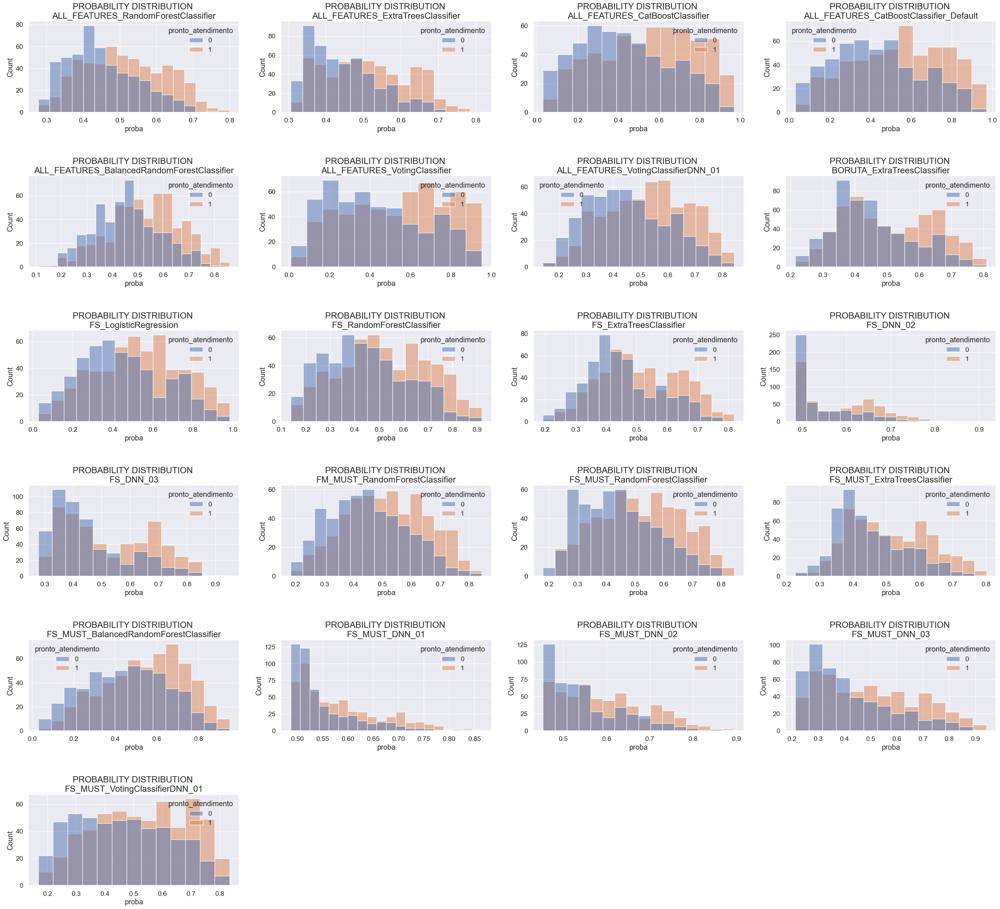

In [61]:
import seaborn as sns

ncols = 4

size = len(predictions_proba)
rows = math.ceil(size / ncols)
width, height = (10, 6)

fig = plt.figure(figsize=(min(ncols * width, 50), rows * height))
fig.subplots_adjust(hspace=0.7, wspace=0.2)

for idx, (name, y_pred) in enumerate(predictions_proba.items(), start=1):
    ax = fig.add_subplot(rows, ncols, idx)
    df_proba = pd.concat(
        [pd.Series(y_pred, name="proba", index=y_test.index), y_test], axis=1
    )
    try:
        sns.histplot(data=df_proba, x="proba", hue=y_test.name, ax=ax)
        ax.set_title(f"PROBABILITY DISTRIBUTION \n{name}", fontsize=20)
    except:
        pass


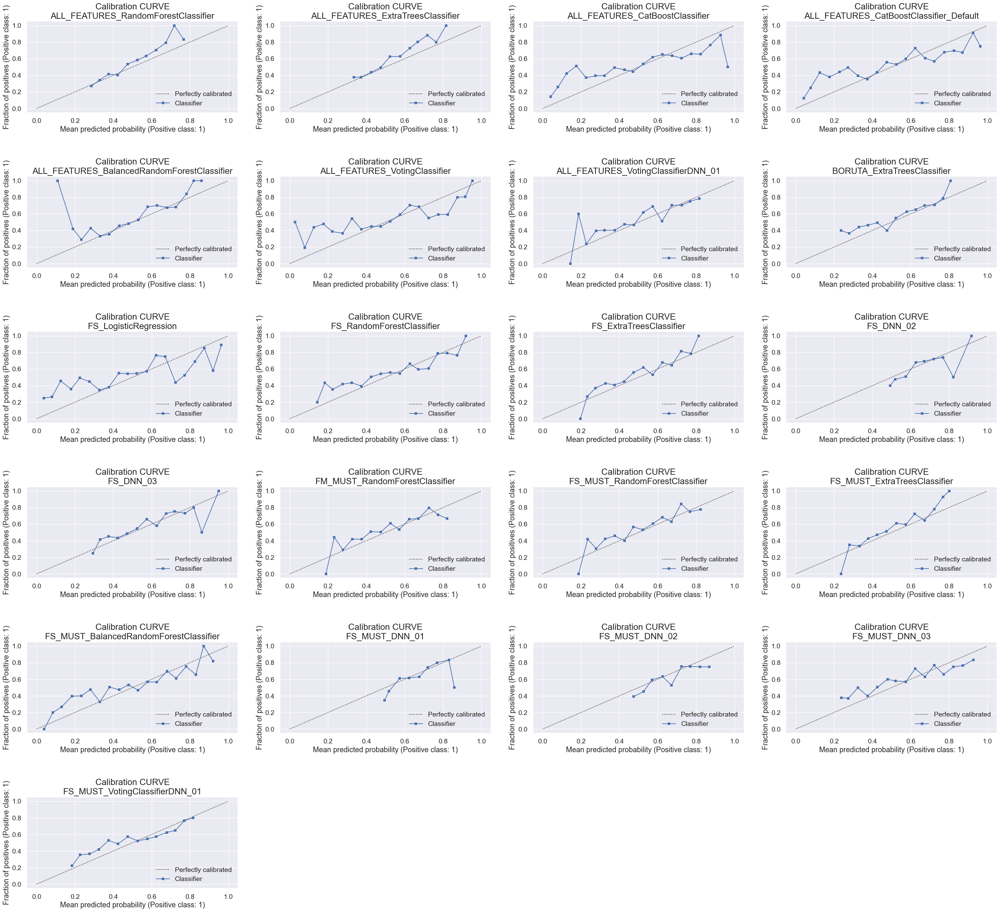

In [62]:
import matplotlib.pyplot as plt
import math

ncols = 4

size = len(predictions_proba)
rows = math.ceil(size / ncols)
width, height = (10, 6)

fig = plt.figure(figsize=(min(ncols * width, 50), rows * height))
fig.subplots_adjust(hspace=0.7, wspace=0.2)

for idx, (name, y_pred) in enumerate(predictions_proba.items(), start=1):
    ax = fig.add_subplot(rows, ncols, idx)
    plot_calibration_curve(
        y_real=y_test,
        y_pred=y_pred,
        title=f"Calibration CURVE\n{name}",
        ax=ax,
        n_bins=20,
    )


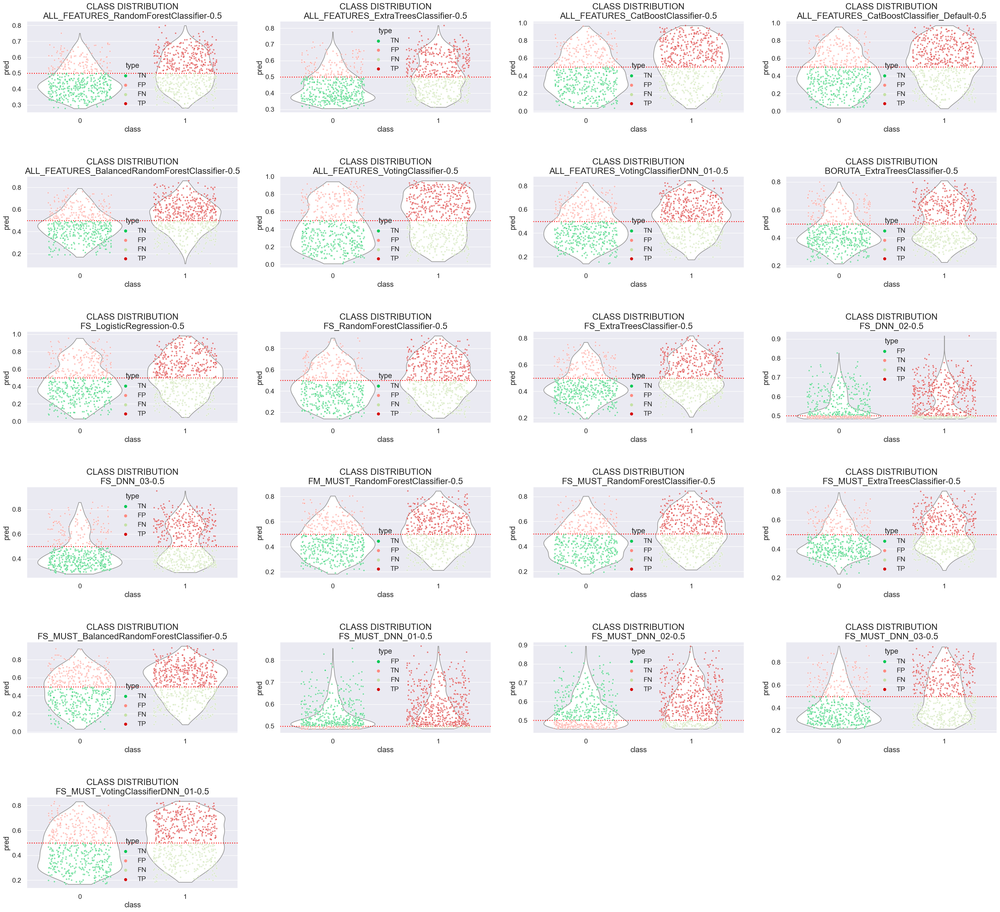

In [63]:
from plot_metric.functions import BinaryClassification
import matplotlib.pyplot as plt
import math

ncols = 4

size = len(predictions_proba)
rows = math.ceil(size / ncols)
width, height = (10, 6)

fig = plt.figure(figsize=(min(ncols * width, 50), rows * height))
fig.subplots_adjust(hspace=0.7, wspace=0.2)

for idx, (name, y_pred) in enumerate(predictions_proba.items(), start=1):
    ax = fig.add_subplot(rows, ncols, idx)
    bc = BinaryClassification(
        y_true=y_test, y_pred=y_pred, labels=["Class 0", "Class 1"], threshold=THRESHOLD
    )
    bc.plot_class_distribution()
    title: ax.set_title(f"CLASS DISTRIBUTION\n{name}-{round(THRESHOLD,2)}", fontsize=20)


# Tunning Hyperparameters

In [64]:
chosen_model_name = "BORUTA_LGBMClassifier"

chosen_model = read_joblib(osp.join(MODELS_DIR, chosen_model_name, "model.p"))
pipe = clone(chosen_model)


In [65]:
# reading files

df_train = pd.read_parquet(osp.join(BORUTA_PATH, "df_train.parquet"))
df_test = pd.read_parquet(osp.join(BORUTA_PATH, "df_test.parquet"))

logger.info(f"df_train shape: {df_train.shape}")
logger.info(f"df_test shape: {df_test.shape}")

X_train = df_train.drop([TARGET], axis=1)
y_train = df_train[TARGET]
X_test = df_test.drop([TARGET], axis=1)
y_test = df_test[TARGET]


In [66]:
pipe


Pipeline(steps=[('preprocessor',
                 Pipeline(steps=[('preprocessor',
                                  ColumnTransformer(remainder='passthrough',
                                                    transformers=[('float',
                                                                   Pipeline(steps=[('imputer',
                                                                                    SimpleImputer()),
                                                                                   ('scaler',
                                                                                    StandardScaler())]),
                                                                   ['nserv',
                                                                    'bmi',
                                                                    'urg']),
                                                                  ('int',
                                                                   Pipeline(steps=[('imputer',
                                                                                    SimpleImputer(strategy='most_frequent')),
                                                                                   ('scaler',
                                                                                    StandardScaler())]),
                                                                   []),
                                                                  ('categorical_l...
                                                                   Pipeline(steps=[('imputer',
                                                                                    SimpleImputer(fill_value='missing',
                                                                                                  strategy='constant')),
                                                                                   ('encoder',
                                                                                    TargetEncoder())]),
                                                                   ['setor',
                                                                    'postoqual',
                                                                    'qplan']),
                                                                  ('bypass',
                                                                   Pipeline(steps=[('Bypass',
                                                                                    <src.ml.utils.preprocessors.BypassTransformer object at 0x291077940>)]),
                                                                   [])])),
                                 ('sparse_to_dense',
                                  SparseToDenseTransformer())])),
                ('model',
                 LGBMClassifier(max_depth=7, random_state=123, verbose=0))])

## Randomized Search CV

In [67]:
preprocessor_search_space = {
    "preprocessor__float__imputer": [
        SimpleImputer(strategy="constant", fill_value=0),
        # SimpleImputer(strategy="constant", fill_value=np.nan),
        SimpleImputer(strategy="mean"),
        SimpleImputer(strategy="median"),
        # IterativeImputer(
        #     random_state=0
        #     , estimator=LGBMRegressor(max_depth = 3, random_state=SEED)
        #     , max_iter=10
        #     , tol=1e-1
        #     )
    ],
    "preprocessor__float__scaler": [
        FunctionTransformer(),
        # FunctionTransformer(func = np.log1p, inverse_func = np.expm1),
        PowerTransformer(method="yeo-johnson", standardize=False),
        # PowerTransformer(method='box-cox', standardize=False),
        MinMaxScaler(),
        StandardScaler(),
    ],
    "preprocessor__int__imputer": [
        SimpleImputer(strategy="constant", fill_value=0),
        # SimpleImputer(strategy="constant", fill_value=np.nan),
        SimpleImputer(strategy="most_frequent"),
        SimpleImputer(strategy="mean"),
        SimpleImputer(strategy="median"),
        # IterativeImputer(
        #     random_state=0
        #     , estimator=LGBMRegressor(max_depth = 3, random_state=SEED)
        #     , max_iter=10
        #     , tol=1e-1
        #     )
    ],
    "preprocessor__int__scaler": [
        FunctionTransformer(),
        # FunctionTransformer(func = np.log1p, inverse_func = np.expm1),
        PowerTransformer(method="yeo-johnson", standardize=False),
        # PowerTransformer(method='box-cox', standardize=False),
        MinMaxScaler(),
        StandardScaler(),
    ],
}


In [68]:
search_space = [
    {
        "model": [LGBMClassifier(random_state=SEED)],
        "model__n_estimators": [30, 100, 400, 700, 1000],
        "model__colsample_bytree": [0.7, 0.8],
        "model__max_depth": [3, 5, 10, 15, 20],
        "model__num_leaves": [50, 100, 200],
        "model__reg_alpha": [1.1, 1.2, 1.3],
        "model__reg_lambda": [1.1, 1.2, 1.3],
        "model__min_split_gain": [0.3, 0.4],
        "model__min_child_samples": [10, 20, 30, 40, 50],
        "model__subsample": [0.7, 0.8, 0.9],
        "model__subsample_freq": [20, 10],
        **preprocessor_search_space,
    }
]


In [69]:
SAMPLE_SIZE = 1000000

X_train_sample = X_train.sample(min(SAMPLE_SIZE, X_train.shape[0]))
# X_train_sample = X_train
y_train_sample = y_train.loc[X_train_sample.index]

optimizer = None
optimizer = RandomizedSearch(
    pipe=pipe,
    search_space=search_space,
    X_train=X_train_sample,
    y_train=y_train_sample,
    scoring=metrics,
    refit="roc_auc",
    n_iter=100,
    n_folds=N_FOLDS,
    verbose=1,
)

print("Finished fitting optimizer")
best_model = optimizer.best_estimator_

print("Retraining best model")

best_model.fit(X_train, y_train)

write_joblib(best_model, osp.join(MODELS_DIR, "best_model.joblib"))


ValueError: 'FIT_TIME' is not a valid scoring value. Use sklearn.metrics.get_scorer_names() to get valid options.

In [ ]:
best_model


In [ ]:
y_pred_train = best_model.predict(X_train)
y_proba_train = best_model.predict_proba(X_train)
y_pred_test = best_model.predict(X_test)
y_proba_test = best_model.predict_proba(X_test)

max_metric_len = max([len(metric_name) for metric_name in metrics])
msg_metrics = f""
for metric_name, scorer in metrics.items():
    train_scorer = get_metric_result(
        scorer, y_train, y_pred_train, y_proba=y_proba_train
    )
    test_scorer = get_metric_result(scorer, y_test, y_pred_test, y_proba=y_proba_test)

    msg_metrics += f" - {metric_name.upper()}{' '*(max_metric_len-len(metric_name))}\t->\tTRAIN: {train_scorer:.2f} | TEST:{test_scorer:.2f}\n"

print(msg_metrics)


# Best Model

In [ ]:
best_model = read_joblib(osp.join(MODELS_DIR, "best_model.joblib"))

name = chosen_model_name

y_pred_train = best_model.predict(X_train)
y_proba_train = best_model.predict_proba(X_train)[:, 1]
y_pred_test = best_model.predict(X_test)
y_proba_test = best_model.predict_proba(X_test)[:, 1]


In [ ]:
y = y_test
y_pred = y_pred_test
y_proba = y_proba_test


## Metrics

### Precision and Recall x Threshold

In [ ]:
import matplotlib.pyplot as plt
import math

width, height = (10, 6)

fig = plt.figure(figsize=(min(width, 50), height))
fig.subplots_adjust(hspace=0.7, wspace=0.2)

ax = fig.add_subplot(1, 1, 1)

plot_precision_recall_vs_threshold(
    y_real=y, y_pred=y_proba, title=f"Precision and Recall X Threshold\n{name}", ax=ax
)


### Calibration Curve

In [ ]:
width, height = (10, 6)

fig = plt.figure(figsize=(min(width, 50), height))
fig.subplots_adjust(hspace=0.7, wspace=0.2)

ax = fig.add_subplot(1, 1, 1)

plot_calibration_curve(
    y_real=y, y_pred=y_proba, title=f"Calibration CURVE\n{name}", ax=ax, n_bins=20
)


### Probability Distribution

In [ ]:
width, height = (10, 6)

fig = plt.figure(figsize=(min(width, 50), height))
fig.subplots_adjust(hspace=0.7, wspace=0.2)

ax = fig.add_subplot(1, 1, 1)

df_proba = pd.concat([pd.Series(y_proba, name="proba", index=y.index), y], axis=1)

sns.histplot(data=df_proba, x="proba", hue=y.name, ax=ax)
ax.set_title(f"PROBABILITY DISTRIBUTION \n{name}", fontsize=20)

plt.show()


### Confusion Matrix x Threshold

In [ ]:
import matplotlib.pyplot as plt
import math

ncols = 5
THRESHOLDS = np.arange(0.05, 1.05, 0.05)

size = len(THRESHOLDS)
rows = math.ceil(size / ncols)
width, height = (10, 6)

fig = plt.figure(figsize=(min(ncols * width, 50), rows * height))
fig.subplots_adjust(hspace=0.7, wspace=0.2)

for idx, threshold in enumerate(THRESHOLDS, start=1):
    ax = fig.add_subplot(rows, ncols, idx)
    y_pred_threshold = best_model.predict_proba(X_test)[:, 1] > threshold
    plot_confusion_matrix(
        y_real=y,
        y_pred=y_pred_threshold,
        title=f"Confusion Matrix\n{name}-{round(threshold,2)}",
        ax=ax,
    )


### Classification Report x Threshold

In [ ]:
import matplotlib.pyplot as plt
import math

ncols = 5
THRESHOLDS = np.arange(0.05, 1.05, 0.05)

size = len(THRESHOLDS)
rows = math.ceil(size / ncols)
width, height = (10, 6)

fig = plt.figure(figsize=(min(ncols * width, 50), rows * height))
fig.subplots_adjust(hspace=0.7, wspace=0.2)

for idx, threshold in enumerate(THRESHOLDS, start=1):
    ax = fig.add_subplot(rows, ncols, idx)
    y_pred_threshold = best_model.predict_proba(X_test)[:, 1] > threshold
    plot_classification_report_sns(
        y_real=y,
        y_pred=y_pred_threshold,
        title=f"Classification Report\n{name}-{round(threshold,2)}",
        ax=ax,
    )


### Defining Threshold

In [ ]:
THRESHOLD = 0.35
y_pred = best_model.predict_proba(X_test)[:, 1] > THRESHOLD


### Confusion Matrix

In [ ]:
plot_confusion_matrix(
    y_real=y, y_pred=y_pred, title=f"Confusion Matrix\n{name}-{round(THRESHOLD,2)}"
)


### Classification Report

In [ ]:
plot_classification_report_sns(
    y_real=y, y_pred=y_pred, title=f"Classification Report\n{name}-{round(THRESHOLD,2)}"
)


### Roc Curve

In [ ]:
from plot_metric.functions import BinaryClassification

f, ax = plt.subplots(figsize=(10, 6))
bc = BinaryClassification(
    y_true=y, y_pred=y_proba, labels=["Class 1", "Class 2"], threshold=THRESHOLD
)
bc.plot_roc_curve()
title: ax.set_title(f"ROC CURVE\n{name}-{round(THRESHOLD,2)}", fontsize=20)


### Precision x Recall

In [ ]:
from plot_metric.functions import BinaryClassification

f, ax = plt.subplots(figsize=(10, 6))
bc = BinaryClassification(
    y_true=y, y_pred=y_proba, labels=["Class 0", "Class 1"], threshold=THRESHOLD
)
bc.plot_precision_recall_curve()
title: ax.set_title(f"PRECISION X RECALL\n{name}-{round(THRESHOLD,2)}", fontsize=20)


### Class Distribution

In [ ]:
from plot_metric.functions import BinaryClassification

f, ax = plt.subplots(figsize=(10, 6))
bc = BinaryClassification(
    y_true=y, y_pred=y_proba, labels=["Class 0", "Class 1"], threshold=THRESHOLD
)
bc.plot_class_distribution()
title: ax.set_title(f"CLASS DISTRIBUTION\n{name}-{round(THRESHOLD,2)}", fontsize=20)


## Shap

In [ ]:
import shap

shap.initjs()

model = best_model

# Using a random sample of the dataframe for better time computation
X_train_sampled = X_train.sample(30, random_state=10)
X_test_sampled = X_test.sample(1000, random_state=10)


# explain the model's predictions using SHAP values
def model_predict(data_asarray, model=model, columns=X_train_sampled.columns):
    data_asframe = pd.DataFrame(data_asarray, columns=columns)
    predictions = model.predict_proba(data_asframe)
    return predictions


explainer = shap.KernelExplainer(
    model=model_predict, data=X_train_sampled, link="identity"
)
shap_values = explainer.shap_values(X_test_sampled)


In [ ]:
shap.summary_plot(shap_values[1], X_test_sampled, plot_size=(18, 10))


In [ ]:
shap.force_plot(
    explainer.expected_value[0],
    shap_values[0][0],
    feature_names=X_train_sampled.columns,
    link="logit",
)


In [ ]:
shap.plots._waterfall.waterfall_legacy(
    explainer.expected_value[1],
    shap_values[1][0],
    feature_names=X_train_sampled.columns,
)


In [ ]:
shap.summary_plot(
    shap_values,
    plot_type="bar",
    feature_names=X_train_sampled.columns,
    plot_size=(18, 10),
)


In [ ]:
shap.decision_plot(
    explainer.expected_value[1],
    shap_values[1][:500],
    feature_names=X_test_sampled.columns.to_list(),
    xlim=(-0.1, 1),
    feature_order="hclust",
)


In [ ]:
shap.plots.force(
    explainer.expected_value[1],
    shap_values[1],
    feature_names=X_test_sampled.columns.to_list(),
)
